# Climate Change Visualizations

This notebook explores and visualizes the surface temperature datasets and looks at relationship of surface temperature with greenhouse gas emissions and sea-ice extent. The sources of the datasets are:

1. Climate Change: Earth Surface Temperature Data (1750-2015): https://berkeleyearth.org/data/
2. Greenhouse Gas Emissions (1990-2017): http://data.un.org/Explorer.aspx
3. Sea-Ice Extent UNData (1978-2019): https://www.kaggle.com/datasets/nsidcorg/daily-sea-ice-extent-data 

The structure of the notebook is as follows:
* Importing the relevant libraries
* Loading the datasets
* Analyzing and visualizing the global dataset
* Analyzing and visualizing the sea-ice extent
* Analyzing and visualizing the greenhouse gas dataset
* Analyzing and visualizing the country dataset
* Analyzing and visualizing the city dataset
* Analyzing and visualizing the state dataset
* Saving the newly created dataframes as csv files
* Combining all visuals into an interactive dashboard using Dash

## Importing the required libraries

In [1]:
import pandas as pd
import plotly.express as px
from plotly.offline import iplot
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import country_converter as coco
from dash import Dash, dcc, Output, Input
import dash_bootstrap_components as dbc
from dash import html

## Loading the data

In [2]:
global_data = pd.read_csv('./data/GlobalTemperatures.csv')
country_data = pd.read_csv('./data/GlobalLandTemperaturesByCountry.csv')
state_data = pd.read_csv('./data/GlobalLandTemperaturesByState.csv')
major_city_data = pd.read_csv('./data/GlobalLandTemperaturesByMajorCity.csv')
city_data = pd.read_csv('./data/GlobalLandTemperaturesByCity.csv')
green_house_gas_data = pd.read_csv('./data/greenhouse_gas_inventory_data.csv')
sea_ice_df = pd.read_csv('./data/seaice.csv')

# Global Temperature Data

In [3]:
# quick look
global_data

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1750-01-01,3.034,3.574,NaN,NaN,NaN,NaN,NaN,NaN
1,1750-02-01,3.083,3.702,NaN,NaN,NaN,NaN,NaN,NaN
2,1750-03-01,5.626,3.076,NaN,NaN,NaN,NaN,NaN,NaN
3,1750-04-01,8.490,2.451,NaN,NaN,NaN,NaN,NaN,NaN
4,1750-05-01,11.573,2.072,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
3187,2015-08-01,14.755,0.072,20.699,0.110,9.005,0.170,17.589,0.057
3188,2015-09-01,12.999,0.079,18.845,0.088,7.199,0.229,17.049,0.058
3189,2015-10-01,10.801,0.102,16.450,0.059,5.232,0.115,16.290,0.062
3190,2015-11-01,7.433,0.119,12.892,0.093,2.157,0.106,15.252,0.063


In [4]:
# checking datasets info
global_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3192 entries, 0 to 3191
Data columns (total 9 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   dt                                         3192 non-null   object 
 1   LandAverageTemperature                     3180 non-null   float64
 2   LandAverageTemperatureUncertainty          3180 non-null   float64
 3   LandMaxTemperature                         1992 non-null   float64
 4   LandMaxTemperatureUncertainty              1992 non-null   float64
 5   LandMinTemperature                         1992 non-null   float64
 6   LandMinTemperatureUncertainty              1992 non-null   float64
 7   LandAndOceanAverageTemperature             1992 non-null   float64
 8   LandAndOceanAverageTemperatureUncertainty  1992 non-null   float64
dtypes: float64(8), object(1)
memory usage: 224.6+ KB


In [5]:
# summarizing datasets statistics
global_data.describe()

,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
count,3180.000000,3180.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000
mean,8.374731,0.938468,14.350601,0.479782,2.743595,0.431849,15.212566,0.128532
std,4.381310,1.096440,4.309579,0.583203,4.155835,0.445838,1.274093,0.073587
min,-2.080000,0.034000,5.900000,0.044000,-5.407000,0.045000,12.475000,0.042000
25%,4.312000,0.186750,10.212000,0.142000,-1.334500,0.155000,14.047000,0.063000
50%,8.610500,0.392000,14.760000,0.252000,2.949500,0.279000,15.251000,0.122000
75%,12.548250,1.419250,18.451500,0.539000,6.778750,0.458250,16.396250,0.151000
max,19.021000,7.880000,21.320000,4.373000,9.715000,3.498000,17.611000,0.457000


In [6]:
# Checking the null values ratio
global_data.isnull().sum()/len(global_data)

dt                                           0.000000
LandAverageTemperature                       0.003759
LandAverageTemperatureUncertainty            0.003759
LandMaxTemperature                           0.375940
LandMaxTemperatureUncertainty                0.375940
LandMinTemperature                           0.375940
LandMinTemperatureUncertainty                0.375940
LandAndOceanAverageTemperature               0.375940
LandAndOceanAverageTemperatureUncertainty    0.375940
dtype: float64

In [7]:
global_data.dropna(axis=0, inplace=True)

global_data['Date'] = pd.to_datetime(global_data.dt)
global_data.drop(columns=['dt'], axis=1, inplace=True)

global_data['Day'] = global_data['Date'].dt.day
global_data['Month'] = global_data['Date'].dt.month
global_data['Year'] = global_data['Date'].dt.year

global_data = global_data[~(global_data['Year'] < 1900)]
global_data = global_data[~(global_data['Year'] > 2013)]

In [8]:
global_data

,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty,Date,Day,Month,Year
1800,1.461,0.276,7.193,0.465,-4.102,0.395,13.142,0.142,1900-01-01,1,1,1900
1801,3.098,0.416,9.181,0.604,-2.814,0.626,13.777,0.173,1900-02-01,1,2,1900
1802,5.492,0.261,11.377,0.327,-0.680,0.610,14.400,0.141,1900-03-01,1,3,1900
1803,8.223,0.292,13.972,0.342,2.131,0.394,15.170,0.151,1900-04-01,1,4,1900
1804,11.385,0.357,17.415,0.329,5.179,0.379,15.955,0.159,1900-05-01,1,5,1900
...,...,...,...,...,...,...,...,...,...,...,...,...
3163,14.742,0.129,20.596,0.120,9.014,0.179,17.462,0.068,2013-08-01,1,8,2013
3164,13.154,0.104,18.947,0.077,7.482,0.194,16.894,0.064,2013-09-01,1,9,2013
3165,10.256,0.077,15.994,0.100,4.663,0.135,15.905,0.062,2013-10-01,1,10,2013
3166,7.424,0.079,12.965,0.113,2.016,0.116,15.107,0.062,2013-11-01,1,11,2013


In [9]:
# grouping data by year
yearly_global_data = global_data.groupby('Year')[['LandAverageTemperature', 'LandAverageTemperatureUncertainty',
                            'LandMaxTemperature', 'LandMaxTemperatureUncertainty',
                            'LandMinTemperature', 'LandMinTemperatureUncertainty',
                            'LandAndOceanAverageTemperature',
                            'LandAndOceanAverageTemperatureUncertainty']].mean().reset_index()
yearly_global_data

,Year,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1900,8.501583,0.314750,14.389500,0.387583,2.575667,0.406250,15.143917,0.150250
1,1901,8.541917,0.306250,14.512167,0.448167,2.490500,0.397500,15.073333,0.145750
2,1902,8.304417,0.292750,14.364250,0.394333,2.203750,0.356167,14.958333,0.135500
3,1903,8.220167,0.290000,14.085750,0.389750,2.283333,0.378250,14.836583,0.134833
4,1904,8.090917,0.286417,14.063667,0.500000,2.171083,0.337750,14.810417,0.133083
...,...,...,...,...,...,...,...,...,...
109,2009,9.505250,0.085917,15.266583,0.107750,3.796917,0.126000,15.827167,0.058917
110,2010,9.703083,0.083417,15.449000,0.103417,4.023917,0.115667,15.895500,0.058583
111,2011,9.516000,0.082000,15.284833,0.114333,3.827667,0.136583,15.769500,0.059000
112,2012,9.507333,0.083417,15.332833,0.107333,3.756167,0.145333,15.802333,0.061500


In [10]:
# creating two dataframes, one for land temperature, and one for land&ocean temperature
avg_land_temp = yearly_global_data.groupby('Year')['LandAverageTemperature', 'LandAverageTemperatureUncertainty'].mean().reset_index()
display(avg_land_temp)
avg_land_ocean_temp = yearly_global_data.groupby('Year')['LandAndOceanAverageTemperature', 'LandAndOceanAverageTemperatureUncertainty'].mean().reset_index()
display(avg_land_ocean_temp)

/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/2373151981.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Year,LandAverageTemperature,LandAverageTemperatureUncertainty
0,1900,8.501583,0.314750
1,1901,8.541917,0.306250
2,1902,8.304417,0.292750
3,1903,8.220167,0.290000
4,1904,8.090917,0.286417
...,...,...,...
109,2009,9.505250,0.085917
110,2010,9.703083,0.083417
111,2011,9.516000,0.082000
112,2012,9.507333,0.083417


/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/2373151981.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Year,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1900,15.143917,0.150250
1,1901,15.073333,0.145750
2,1902,14.958333,0.135500
3,1903,14.836583,0.134833
4,1904,14.810417,0.133083
...,...,...,...
109,2009,15.827167,0.058917
110,2010,15.895500,0.058583
111,2011,15.769500,0.059000
112,2012,15.802333,0.061500


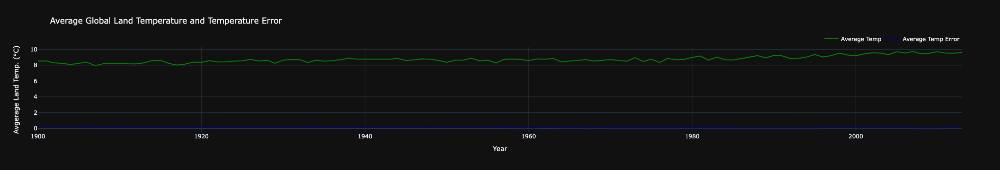

In [11]:
land_temp_plot = go.Scatter(
    x = avg_land_temp['Year'],y = avg_land_temp['LandAverageTemperature'],
    name="Average Temp",
    marker=dict(color="Green"),
    # mode = "markers+lines"
)
land_temp_error_plot = go.Scatter(
    x = avg_land_temp['Year'],y = avg_land_temp['LandAverageTemperatureUncertainty'],
    name="Average Temp Error",
    marker=dict(color="Navy"),
    # mode = "markers+lines"
)

data1 = [land_temp_plot, land_temp_error_plot]
layout1 = dict(title = 'Average Global Land Temperature and Temperature Error',
          xaxis = dict(title = 'Year', showticklabels=True), 
          yaxis = dict(title = 'Avgerage Land Temp. (°C)', showticklabels=True),
          hovermode = 'closest',
          legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
          template="plotly_dark",)
line1 = dict(data=data1, layout=layout1)
iplot(line1, filename='avg_land_temp')

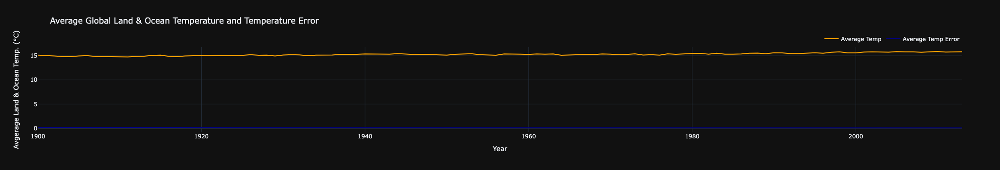

In [12]:
land_ocean_temp_plot = go.Scatter(
    x = avg_land_ocean_temp['Year'],y = avg_land_ocean_temp['LandAndOceanAverageTemperature'],
    name="Average Temp",
    marker=dict(color="Orange"),
    # mode = "markers+lines",
)
land_ocean_temp_error_plot = go.Scatter(
    x = avg_land_ocean_temp['Year'],y = avg_land_ocean_temp['LandAndOceanAverageTemperatureUncertainty'],
    name="Average Temp Error",
    marker=dict(color="Navy"),
    # mode = "markers+lines"
)

data2 = [land_ocean_temp_plot, land_ocean_temp_error_plot]
layout2 = dict(title = 'Average Global Land & Ocean Temperature and Temperature Error',
          xaxis = dict(title = 'Year', showticklabels=True), 
          yaxis = dict(title = 'Avgerage Land & Ocean Temp. (°C)', showticklabels=True),
          hovermode = 'closest',
          legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1
         ),
         template="plotly_dark",)
line2 = dict(data=data2, layout=layout2)
iplot(line2, filename='avg_land_ocean_temp')

In [13]:
year_month = global_data.groupby(by = ['Year', 'Month']).mean().reset_index()
year_month

,Year,Month,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty,Day
0,1900,1,1.461,0.276,7.193,0.465,-4.102,0.395,13.142,0.142,1.0
1,1900,2,3.098,0.416,9.181,0.604,-2.814,0.626,13.777,0.173,1.0
2,1900,3,5.492,0.261,11.377,0.327,-0.680,0.610,14.400,0.141,1.0
3,1900,4,8.223,0.292,13.972,0.342,2.131,0.394,15.170,0.151,1.0
4,1900,5,11.385,0.357,17.415,0.329,5.179,0.379,15.955,0.159,1.0
...,...,...,...,...,...,...,...,...,...,...,...
1363,2013,8,14.742,0.129,20.596,0.120,9.014,0.179,17.462,0.068,1.0
1364,2013,9,13.154,0.104,18.947,0.077,7.482,0.194,16.894,0.064,1.0
1365,2013,10,10.256,0.077,15.994,0.100,4.663,0.135,15.905,0.062,1.0
1366,2013,11,7.424,0.079,12.965,0.113,2.016,0.116,15.107,0.062,1.0


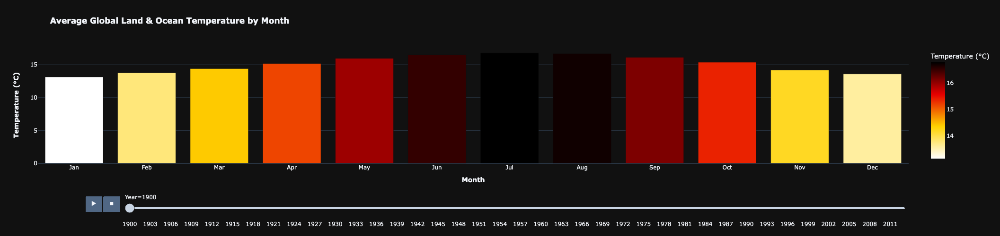

In [14]:
bar1 = px.bar(year_month, x='Month', y='LandAndOceanAverageTemperature', color='LandAndOceanAverageTemperature', animation_frame='Year', 
              title='<b>Average Global Land & Ocean Temperature by Month<b>', labels={'LandAndOceanAverageTemperature':'Temperature (°C)'}, 
              color_continuous_scale=px.colors.sequential.Hot_r,)
bar1.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=[1,2,3,4,5,6,7,8,9,10,11,12],
        ticktext=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']))

bar1.update_xaxes(title='<b>Month<b>')
bar1.update_yaxes(title='<b>Temperature (°C)<b>')
bar1.update_layout(showlegend=False,
                  template="plotly_dark",
                  height=500)
bar1.show()

In [15]:
import calendar
year_month['Month'] = year_month['Month'].apply(lambda x: calendar.month_abbr[x])

In [16]:
polar1 = px.bar_polar(year_month, r="LandAndOceanAverageTemperature", theta="Month",
                      color="LandAndOceanAverageTemperature", template="plotly_dark",
                      animation_frame='Year', 
                      color_continuous_scale = px.colors.sequential.Hot,
                      hover_data=['Month'],
                      title='<b>Monthly Land & Ocean Temperature Throughout the Years<b>',
                      labels={'LandAndOceanAverageTemperature':'Temperature (°C)'},
                      height=500)
polar1.show()

In [17]:
year_month

,Year,Month,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty,Day
0,1900,Jan,1.461,0.276,7.193,0.465,-4.102,0.395,13.142,0.142,1.0
1,1900,Feb,3.098,0.416,9.181,0.604,-2.814,0.626,13.777,0.173,1.0
2,1900,Mar,5.492,0.261,11.377,0.327,-0.680,0.610,14.400,0.141,1.0
3,1900,Apr,8.223,0.292,13.972,0.342,2.131,0.394,15.170,0.151,1.0
4,1900,May,11.385,0.357,17.415,0.329,5.179,0.379,15.955,0.159,1.0
...,...,...,...,...,...,...,...,...,...,...,...
1363,2013,Aug,14.742,0.129,20.596,0.120,9.014,0.179,17.462,0.068,1.0
1364,2013,Sep,13.154,0.104,18.947,0.077,7.482,0.194,16.894,0.064,1.0
1365,2013,Oct,10.256,0.077,15.994,0.100,4.663,0.135,15.905,0.062,1.0
1366,2013,Nov,7.424,0.079,12.965,0.113,2.016,0.116,15.107,0.062,1.0


In [18]:
overall_temp = year_month.groupby(year_month['Year'])['LandAverageTemperature','LandMaxTemperature',
                                                      'LandMinTemperature','LandAndOceanAverageTemperature'].mean().reset_index()

line3 = go.Figure()

# Add traces
line3.add_trace(go.Scatter(x=overall_temp.Year, y=overall_temp.LandAverageTemperature,
                    mode='lines',
                    name='Land Avg',
                    marker_color='darkgreen'))
line3.add_trace(go.Scatter(x=overall_temp.Year, y=overall_temp.LandMaxTemperature,
                    mode='lines',
                    name='Land Max',
                    marker_color='brown'))
line3.add_trace(go.Scatter(x=overall_temp.Year, y=overall_temp.LandMinTemperature,
                    mode='lines',
                    name='Land Min',
                    marker_color='skyblue'))
line3.add_trace(go.Scatter(x=overall_temp.Year, y=overall_temp.LandAndOceanAverageTemperature,
                    mode='lines',
                    name='Land & Ocean Avg',
                    marker_color='yellow'))

line3.update_layout(
    xaxis_title="<b>Years<b>",
    yaxis_title='<b>Temperatures (°C)<b>',
    title_text='<b>Global Land and Ocean Temperature<b>',
)
line3.update_layout(
    template="plotly_dark",
    height=600,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=0.8
))

line3.update_layout(showlegend=True)
line3.show()

/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/2594491490.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



# Sea-ice Extent Data

In [19]:
sea_ice_df

,Year,Month,Day,Extent,Missing,Source Data,hemisphere
0,1978,10,26,10.231,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsid...,north
1,1978,10,28,10.420,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsid...,north
2,1978,10,30,10.557,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsid...,north
3,1978,11,1,10.670,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsid...,north
4,1978,11,3,10.777,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsid...,north
...,...,...,...,...,...,...,...
26349,2019,5,27,10.085,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsidc...,south
26350,2019,5,28,10.078,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsidc...,south
26351,2019,5,29,10.219,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsidc...,south
26352,2019,5,30,10.363,0.0,['ftp://sidads.colorado.edu/pub/DATASETS/nsidc...,south


In [20]:
sea_ice_df.columns

Index(['Year', ' Month', ' Day', '     Extent', '    Missing', ' Source Data',
       'hemisphere'],
      dtype='object')

In [21]:
sea_ice_df.rename(columns={'     Extent':'Extent'},inplace=True)

In [22]:
sea_ice_yearly = sea_ice_df.groupby('Year')['Extent'].mean().reset_index()
sea_ice_yearly

,Year,Extent
0,1978,12.976838
1,1979,12.019349
2,1980,11.785219
3,1981,11.776148
4,1982,12.048755
5,1983,11.852904
6,1984,11.681139
7,1985,11.810214
8,1986,11.639773
9,1987,12.149411


In [23]:
sea_ice_merged = yearly_global_data.merge(sea_ice_yearly, on=['Year'])
sea_ice_merged = sea_ice_merged.groupby('Year')['LandAndOceanAverageTemperature','Extent'].mean().reset_index()
sea_ice_merged

/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/400375039.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Year,LandAndOceanAverageTemperature,Extent
0,1978,15.300917,12.976838
1,1979,15.414167,12.019349
2,1980,15.491833,11.785219
3,1981,15.516167,11.776148
4,1982,15.341917,12.048755
5,1983,15.520250,11.852904
6,1984,15.344167,11.681139
7,1985,15.340667,11.810214
8,1986,15.384000,11.639773
9,1987,15.524500,12.149411


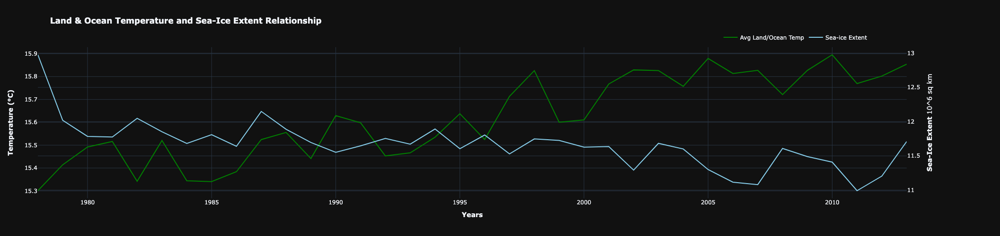

In [24]:
# Create figure with secondary y-axis
line4 = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
line4.add_trace(go.Scatter(x=sea_ice_merged.Year, y=sea_ice_merged.LandAndOceanAverageTemperature,
                    # mode='lines',
                    name='Avg Land/Ocean Temp',
                    marker_color='green'),
                    secondary_y=False)
line4.add_trace(go.Scatter(x=sea_ice_merged.Year, y=sea_ice_merged.Extent,
                    # mode='lines',
                    name='Sea-ice Extent',
                    marker_color='skyblue'),
                    secondary_y=True)

# Add figure title
line4.update_layout(
    title_text="<b>Land & Ocean Temperature and Sea-Ice Extent Relationship<b>",
    template="plotly_dark",
    height=500,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=0.9
))

# Set x-axis title
line4.update_xaxes(title_text="<b>Years<b>")

# Set y-axes titles
line4.update_yaxes(title_text="<b>Temperature (°C)</b>", secondary_y=False)
line4.update_yaxes(title_text="<b>Sea-Ice Extent</b> 10^6 sq km", secondary_y=True)

line4.show()

# Green House Gas Data Prep

In [25]:
green_house_gas_data

,country_or_area,year,value,category
0,Australia,2014,393126.946994,carbon_dioxide_co2_emissions_without_land_use_...
1,Australia,2013,396913.936530,carbon_dioxide_co2_emissions_without_land_use_...
2,Australia,2012,406462.847704,carbon_dioxide_co2_emissions_without_land_use_...
3,Australia,2011,403705.528314,carbon_dioxide_co2_emissions_without_land_use_...
4,Australia,2010,406200.993184,carbon_dioxide_co2_emissions_without_land_use_...
...,...,...,...,...
8401,United States of America,1994,593.222570,unspecified_mix_of_hydrofluorocarbons_hfcs_and...
8402,United States of America,1993,586.939752,unspecified_mix_of_hydrofluorocarbons_hfcs_and...
8403,United States of America,1992,574.414624,unspecified_mix_of_hydrofluorocarbons_hfcs_and...
8404,United States of America,1991,566.900968,unspecified_mix_of_hydrofluorocarbons_hfcs_and...


In [26]:
green_house_gas_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   country_or_area  8406 non-null   object 
 1   year             8406 non-null   int64  
 2   value            8406 non-null   float64
 3   category         8406 non-null   object 
dtypes: float64(1), int64(1), object(2)
memory usage: 262.8+ KB


In [27]:
green_house_gas_data.describe()

,year,value
count,8406.000000,8.406000e+03
mean,2002.188437,2.055472e+05
std,7.151605,8.041504e+05
min,1990.000000,1.103750e-06
25%,1996.000000,2.976980e+02
50%,2002.000000,7.840318e+03
75%,2008.000000,6.589885e+04
max,2014.000000,7.422208e+06


In [28]:
co2_data = green_house_gas_data.copy()
co2_data = co2_data.groupby(['year','country_or_area'])[['value', 'category']].mean().reset_index()
co2_data['Country_Code'] = coco.convert(names=co2_data['country_or_area'], to='ISO3')
co2_data.drop(co2_data.index[co2_data['Country_Code'] == 'not found'], inplace=True)
co2_data['Continent'] = coco.convert(names = co2_data['country_or_area'], to = 'continent')

European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex
European Union not found in regex


In [29]:
co2_data

,year,country_or_area,value,Country_Code,Continent
0,1990,Australia,1.569836e+05,AUS,Oceania
1,1990,Austria,2.956674e+04,AUT,Europe
2,1990,Belarus,8.007430e+04,BLR,Europe
3,1990,Belgium,6.258053e+04,BEL,Europe
4,1990,Bulgaria,4.138031e+04,BGR,Europe
...,...,...,...,...,...
1069,2014,Switzerland,1.621911e+04,CHE,Europe
1070,2014,Turkey,2.337752e+05,TUR,Asia
1071,2014,Ukraine,1.518632e+05,UKR,Europe
1072,2014,United Kingdom,1.318752e+05,GBR,Europe


In [30]:
co2_data.rename(columns={'year':'Year', 'country_or_area':'Country'}, inplace=True)
co2_data

,Year,Country,value,Country_Code,Continent
0,1990,Australia,1.569836e+05,AUS,Oceania
1,1990,Austria,2.956674e+04,AUT,Europe
2,1990,Belarus,8.007430e+04,BLR,Europe
3,1990,Belgium,6.258053e+04,BEL,Europe
4,1990,Bulgaria,4.138031e+04,BGR,Europe
...,...,...,...,...,...
1069,2014,Switzerland,1.621911e+04,CHE,Europe
1070,2014,Turkey,2.337752e+05,TUR,Asia
1071,2014,Ukraine,1.518632e+05,UKR,Europe
1072,2014,United Kingdom,1.318752e+05,GBR,Europe


In [31]:
co2_data.isnull().sum()

Year            0
Country         0
value           0
Country_Code    0
Continent       0
dtype: int64

In [32]:
ghg_merged = yearly_global_data.merge(co2_data, on=['Year'])
ghg_merged = ghg_merged.groupby('Year')['LandAndOceanAverageTemperature','value'].mean().reset_index()
ghg_merged

/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/2815564828.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Year,LandAndOceanAverageTemperature,value
0,1990,15.629333,162134.629969
1,1991,15.598000,157528.956358
2,1992,15.453000,151030.343680
3,1993,15.466417,148824.915673
4,1994,15.535000,144954.332390
5,1995,15.637833,143090.652532
6,1996,15.524667,144370.639320
7,1997,15.713833,142634.220084
8,1998,15.826000,141456.835554
9,1999,15.600333,141048.220791


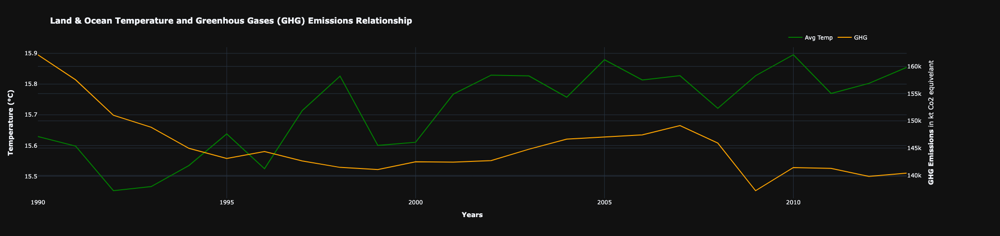

In [33]:
# Create figure with secondary y-axis
line5 = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
line5.add_trace(go.Scatter(x=ghg_merged.Year, y=ghg_merged.LandAndOceanAverageTemperature,
                    # mode='lines',
                    name='Avg Temp',
                    marker_color='green'),
                    secondary_y=False)
line5.add_trace(go.Scatter(x=ghg_merged.Year, y=ghg_merged.value,
                    # mode='lines',
                    name='GHG',
                    marker_color='orange'),
                    secondary_y=True)

# Add figure title
line5.update_layout(
    title_text="<b>Land & Ocean Temperature and Greenhous Gases (GHG) Emissions Relationship<b>",
    template="plotly_dark",
    height=500,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=0.9
))

# Set x-axis title
line5.update_xaxes(title_text="<b>Years<b>")

# Set y-axes titles
line5.update_yaxes(title_text="<b>Temperature (°C)</b>", secondary_y=False)
line5.update_yaxes(title_text="<b>GHG Emissions</b> in kt Co2 equivelant", secondary_y=True)

line5.show()

# Country/Continent Temperature Data

In [34]:
# quick look
country_data

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland
...,...,...,...,...
577457,2013-05-01,19.059,1.022,Zimbabwe
577458,2013-06-01,17.613,0.473,Zimbabwe
577459,2013-07-01,17.000,0.453,Zimbabwe
577460,2013-08-01,19.759,0.717,Zimbabwe


In [35]:
# info
country_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             577462 non-null  object 
 1   AverageTemperature             544811 non-null  float64
 2   AverageTemperatureUncertainty  545550 non-null  float64
 3   Country                        577462 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


In [36]:
# Stats
country_data.describe()

,AverageTemperature,AverageTemperatureUncertainty
count,544811.000000,545550.000000
mean,17.193354,1.019057
std,10.953966,1.201930
min,-37.658000,0.052000
25%,10.025000,0.323000
50%,20.901000,0.571000
75%,25.814000,1.206000
max,38.842000,15.003000


In [37]:
# null ratio
country_data.isnull().sum()/len(country_data)

dt                               0.000000
AverageTemperature               0.056542
AverageTemperatureUncertainty    0.055263
Country                          0.000000
dtype: float64

In [38]:
# splitting date into day, month, and year
country_data.dropna(axis=0, inplace=True)
country_data['Date'] = pd.to_datetime(country_data.dt)
country_data.drop(columns=['dt'], axis=1, inplace=True)
country_data['Day'] = country_data['Date'].dt.day
country_data['Month'] = country_data['Date'].dt.month
country_data['Year'] = country_data['Date'].dt.year
country_data

,AverageTemperature,AverageTemperatureUncertainty,Country,Date,Day,Month,Year
0,4.384,2.294,Åland,1743-11-01,1,11,1743
5,1.530,4.680,Åland,1744-04-01,1,4,1744
6,6.702,1.789,Åland,1744-05-01,1,5,1744
7,11.609,1.577,Åland,1744-06-01,1,6,1744
8,15.342,1.410,Åland,1744-07-01,1,7,1744
...,...,...,...,...,...,...,...
577456,21.142,0.495,Zimbabwe,2013-04-01,1,4,2013
577457,19.059,1.022,Zimbabwe,2013-05-01,1,5,2013
577458,17.613,0.473,Zimbabwe,2013-06-01,1,6,2013
577459,17.000,0.453,Zimbabwe,2013-07-01,1,7,2013


In [39]:
# grouping data after 1900 & applying coco convert to get iso codes
country_recent = country_data.copy()
country_recent = country_recent.groupby(['Year','Country'])[['AverageTemperature', 'AverageTemperatureUncertainty']].mean().reset_index()
country_recent['Country_Code'] = coco.convert(names=country_recent['Country'], to='ISO3')
country_recent = country_recent[~(country_recent['Year'] < 1900)]

Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
North America not found in regex
Europe not found in regex
North America not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
Europe not found in regex
North America not found in regex
Europe not found in regex
North America not found in regex
Europe not found in regex
North America not found in regex
Europe not found in regex
North America not found in re

In [40]:
country_recent

,Year,Country,AverageTemperature,AverageTemperatureUncertainty,Country_Code
18430,1900,Afghanistan,13.749333,0.748833,AFG
18431,1900,Africa,23.991500,0.482583,not found
18432,1900,Albania,13.068583,0.723417,ALB
18433,1900,Algeria,22.864167,0.826667,DZA
18434,1900,American Samoa,26.273500,0.891000,ASM
...,...,...,...,...,...
45910,2013,Western Sahara,23.744250,1.133125,ESH
45911,2013,Yemen,28.129750,1.335000,YEM
45912,2013,Zambia,21.196000,0.825125,ZMB
45913,2013,Zimbabwe,20.710750,0.778500,ZWE


In [41]:
# dropping rows with code 'not found'
country_recent.drop(country_recent.index[country_recent['Country_Code'] == 'not found'], inplace=True)
country_recent.shape

(26345, 5)

In [42]:
country_recent['Continent'] = coco.convert(names = country_recent['Country'], to = 'continent')

In [43]:
country_recent

,Year,Country,AverageTemperature,AverageTemperatureUncertainty,Country_Code,Continent
18430,1900,Afghanistan,13.749333,0.748833,AFG,Asia
18432,1900,Albania,13.068583,0.723417,ALB,Europe
18433,1900,Algeria,22.864167,0.826667,DZA,Africa
18434,1900,American Samoa,26.273500,0.891000,ASM,Oceania
18435,1900,Andorra,11.348333,0.542167,AND,Europe
...,...,...,...,...,...,...
45910,2013,Western Sahara,23.744250,1.133125,ESH,Africa
45911,2013,Yemen,28.129750,1.335000,YEM,Asia
45912,2013,Zambia,21.196000,0.825125,ZMB,Africa
45913,2013,Zimbabwe,20.710750,0.778500,ZWE,Africa


In [44]:
country_recent.drop(country_recent.index[country_recent['Continent'] == 'not found'], inplace=True)
country_recent

,Year,Country,AverageTemperature,AverageTemperatureUncertainty,Country_Code,Continent
18430,1900,Afghanistan,13.749333,0.748833,AFG,Asia
18432,1900,Albania,13.068583,0.723417,ALB,Europe
18433,1900,Algeria,22.864167,0.826667,DZA,Africa
18434,1900,American Samoa,26.273500,0.891000,ASM,Oceania
18435,1900,Andorra,11.348333,0.542167,AND,Europe
...,...,...,...,...,...,...
45910,2013,Western Sahara,23.744250,1.133125,ESH,Africa
45911,2013,Yemen,28.129750,1.335000,YEM,Asia
45912,2013,Zambia,21.196000,0.825125,ZMB,Africa
45913,2013,Zimbabwe,20.710750,0.778500,ZWE,Africa


In [45]:
country_recent

,Year,Country,AverageTemperature,AverageTemperatureUncertainty,Country_Code,Continent
18430,1900,Afghanistan,13.749333,0.748833,AFG,Asia
18432,1900,Albania,13.068583,0.723417,ALB,Europe
18433,1900,Algeria,22.864167,0.826667,DZA,Africa
18434,1900,American Samoa,26.273500,0.891000,ASM,Oceania
18435,1900,Andorra,11.348333,0.542167,AND,Europe
...,...,...,...,...,...,...
45910,2013,Western Sahara,23.744250,1.133125,ESH,Africa
45911,2013,Yemen,28.129750,1.335000,YEM,Asia
45912,2013,Zambia,21.196000,0.825125,ZMB,Africa
45913,2013,Zimbabwe,20.710750,0.778500,ZWE,Africa


In [46]:
country_recent.isnull().sum()

Year                             0
Country                          0
AverageTemperature               0
AverageTemperatureUncertainty    0
Country_Code                     0
Continent                        0
dtype: int64

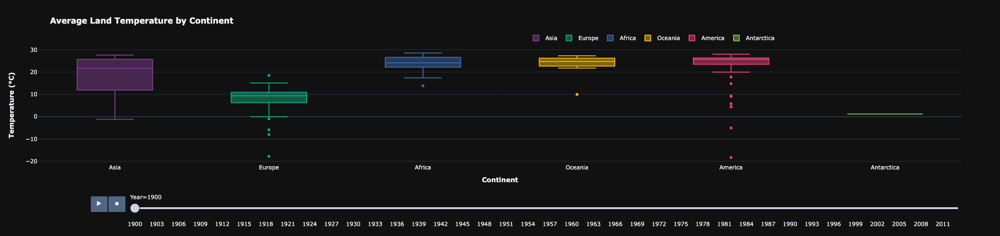

In [47]:
box1 = px.box(country_recent, x='Continent', y='AverageTemperature', hover_data=['AverageTemperature'], animation_frame='Year', color_discrete_sequence=px.colors.qualitative.Bold, color='Continent', title='<b>Average Land Temperature by Continent</b>', labels={'AverageTemperature':'Temperature (°C)'},template="plotly_dark",height=500)
box1.update_layout(legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=0.8),
                   legend_title="")
box1.update_xaxes(title='<b>Continent</b>')
box1.update_yaxes(title='<b>Temperature (°C)</b>')
box1.show()

In [48]:
co2_data

,Year,Country,value,Country_Code,Continent
0,1990,Australia,1.569836e+05,AUS,Oceania
1,1990,Austria,2.956674e+04,AUT,Europe
2,1990,Belarus,8.007430e+04,BLR,Europe
3,1990,Belgium,6.258053e+04,BEL,Europe
4,1990,Bulgaria,4.138031e+04,BGR,Europe
...,...,...,...,...,...
1069,2014,Switzerland,1.621911e+04,CHE,Europe
1070,2014,Turkey,2.337752e+05,TUR,Asia
1071,2014,Ukraine,1.518632e+05,UKR,Europe
1072,2014,United Kingdom,1.318752e+05,GBR,Europe


In [49]:
country_recent

,Year,Country,AverageTemperature,AverageTemperatureUncertainty,Country_Code,Continent
18430,1900,Afghanistan,13.749333,0.748833,AFG,Asia
18432,1900,Albania,13.068583,0.723417,ALB,Europe
18433,1900,Algeria,22.864167,0.826667,DZA,Africa
18434,1900,American Samoa,26.273500,0.891000,ASM,Oceania
18435,1900,Andorra,11.348333,0.542167,AND,Europe
...,...,...,...,...,...,...
45910,2013,Western Sahara,23.744250,1.133125,ESH,Africa
45911,2013,Yemen,28.129750,1.335000,YEM,Asia
45912,2013,Zambia,21.196000,0.825125,ZMB,Africa
45913,2013,Zimbabwe,20.710750,0.778500,ZWE,Africa


In [50]:
ghg_continent = country_recent.merge(co2_data, on=['Year', 'Continent'])
ghg_continent = ghg_continent.groupby(['Year','Continent'])['AverageTemperature','value'].mean().reset_index()
ghg_continent

/var/folders/f9/2v2srzt92v92kmdgggp9r2th0000gn/T/ipykernel_37911/2630396846.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Year,Continent,AverageTemperature,value
0,1990,America,22.843075,1.061941e+06
1,1990,Asia,19.181035,1.766261e+05
2,1990,Europe,9.090849,1.134486e+05
3,1990,Oceania,25.085677,9.259790e+04
4,1991,America,22.851601,1.050916e+06
...,...,...,...,...
91,2012,Oceania,25.101276,1.159252e+05
92,2013,America,23.240602,1.142234e+06
93,2013,Asia,20.344481,2.307138e+05
94,2013,Europe,9.376335,7.694803e+04


In [51]:
ghg_continent.Continent.nunique()

4

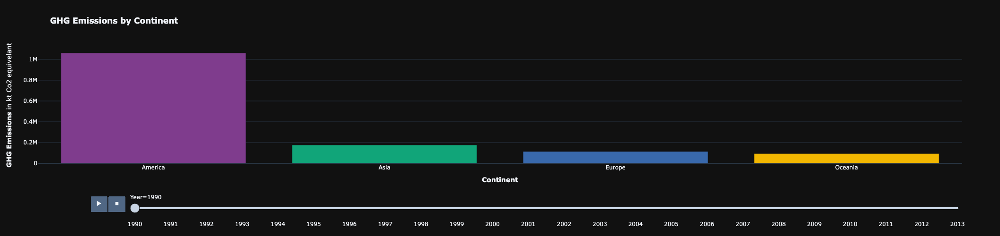

In [52]:
bar2 = px.bar(ghg_continent, x='Continent', y='value', color='Continent', animation_frame='Year', title='<b>GHG Emissions by Continent<b>', color_discrete_sequence=px.colors.qualitative.Bold)

bar2.update_xaxes(title='<b>Continent</b>')
bar2.update_yaxes(title='<b>GHG Emissions</b> in kt Co2 equivelant')
bar2.update_layout(showlegend=False,
                  template="plotly_dark",
                  height=500)
bar2.show()

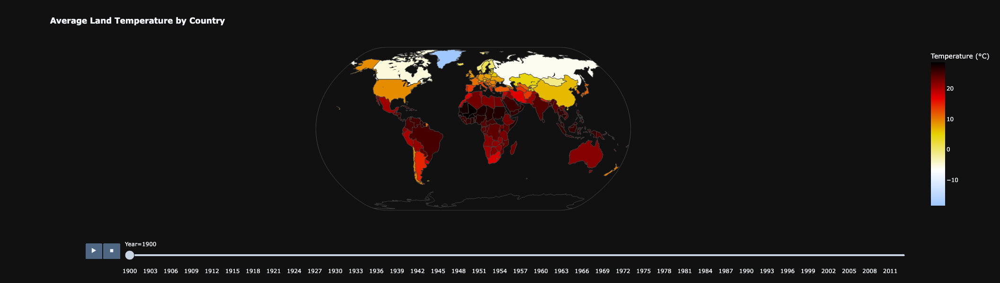

In [53]:
map1 = px.choropleth(country_recent, locations='Country_Code', color='AverageTemperature', hover_name='Country', 
                     animation_frame='Year', color_continuous_scale=px.colors.sequential.Blackbody_r, projection='natural earth', template="plotly_dark", title='<b>Average Land Temperature by Country</b>', height=600, labels={'AverageTemperature':'Temperature (°C)'})
map1.show()

# City Temperature Data

In [54]:
city_data

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Århus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
...,...,...,...,...,...,...,...
8599207,2013-05-01,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E
8599208,2013-06-01,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E
8599209,2013-07-01,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E
8599210,2013-08-01,18.025,0.298,Zwolle,Netherlands,52.24N,5.26E


In [55]:
city_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8599212 entries, 0 to 8599211
Data columns (total 7 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   dt                             object 
 1   AverageTemperature             float64
 2   AverageTemperatureUncertainty  float64
 3   City                           object 
 4   Country                        object 
 5   Latitude                       object 
 6   Longitude                      object 
dtypes: float64(2), object(5)
memory usage: 459.2+ MB


In [56]:
city_data.describe()

,AverageTemperature,AverageTemperatureUncertainty
count,8.235082e+06,8.235082e+06
mean,1.672743e+01,1.028575e+00
std,1.035344e+01,1.129733e+00
min,-4.270400e+01,3.400000e-02
25%,1.029900e+01,3.370000e-01
50%,1.883100e+01,5.910000e-01
75%,2.521000e+01,1.349000e+00
max,3.965100e+01,1.539600e+01


In [57]:
city_data.isnull().sum()

dt                                    0
AverageTemperature               364130
AverageTemperatureUncertainty    364130
City                                  0
Country                               0
Latitude                              0
Longitude                             0
dtype: int64

In [58]:
monthly_temp = city_data.copy()
monthly_temp.dropna(axis=0, inplace=True)
             
monthly_temp['Date'] = pd.to_datetime(monthly_temp.dt)
monthly_temp.drop(columns=['dt'], axis=1, inplace=True)

monthly_temp['Day'] = monthly_temp['Date'].dt.day
monthly_temp['Month'] = monthly_temp['Date'].dt.month
monthly_temp['Year'] = monthly_temp['Date'].dt.year

monthly_temp

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,Date,Day,Month,Year
0,6.068,1.737,Århus,Denmark,57.05N,10.33E,1743-11-01,1,11,1743
5,5.788,3.624,Århus,Denmark,57.05N,10.33E,1744-04-01,1,4,1744
6,10.644,1.283,Århus,Denmark,57.05N,10.33E,1744-05-01,1,5,1744
7,14.051,1.347,Århus,Denmark,57.05N,10.33E,1744-06-01,1,6,1744
8,16.082,1.396,Århus,Denmark,57.05N,10.33E,1744-07-01,1,7,1744
...,...,...,...,...,...,...,...,...,...,...
8599206,7.710,0.182,Zwolle,Netherlands,52.24N,5.26E,2013-04-01,1,4,2013
8599207,11.464,0.236,Zwolle,Netherlands,52.24N,5.26E,2013-05-01,1,5,2013
8599208,15.043,0.261,Zwolle,Netherlands,52.24N,5.26E,2013-06-01,1,6,2013
8599209,18.775,0.193,Zwolle,Netherlands,52.24N,5.26E,2013-07-01,1,7,2013


In [59]:
us_cities = monthly_temp[monthly_temp['Country']=='United States']
us_cities = us_cities[us_cities['Year'] > 1900]
us_cities

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,Date,Day,Month,Year
48527,7.469,0.519,Abilene,United States,32.95N,100.53W,1901-01-01,1,1,1901
48528,4.641,0.660,Abilene,United States,32.95N,100.53W,1901-02-01,1,2,1901
48529,11.482,0.746,Abilene,United States,32.95N,100.53W,1901-03-01,1,3,1901
48530,15.552,0.580,Abilene,United States,32.95N,100.53W,1901-04-01,1,4,1901
48531,21.010,0.334,Abilene,United States,32.95N,100.53W,1901-05-01,1,5,1901
...,...,...,...,...,...,...,...,...,...,...
8439242,15.544,0.281,Yonkers,United States,40.99N,74.56W,2013-05-01,1,5,2013
8439243,20.892,0.273,Yonkers,United States,40.99N,74.56W,2013-06-01,1,6,2013
8439244,24.722,0.279,Yonkers,United States,40.99N,74.56W,2013-07-01,1,7,2013
8439245,21.001,0.323,Yonkers,United States,40.99N,74.56W,2013-08-01,1,8,2013


In [60]:
major_us_cities = us_cities[us_cities['City'].isin(['New York', 'Los Angeles', 'Chicago', 'Houston', 'Pheonix', 'Philadelphia', 'San Antonio', 'San Diego', 'Dallas', 'San Jose', 'Miami'])]
cities_heatmap = major_us_cities.groupby(['City','Month'])['AverageTemperature'].mean().reset_index()
cities_heatmap

,City,Month,AverageTemperature
0,Chicago,1,-0.572080
1,Chicago,2,0.064876
2,Chicago,3,3.712487
3,Chicago,4,7.415097
4,Chicago,5,11.834885
...,...,...,...
115,San Jose,8,19.611965
116,San Jose,9,19.064142
117,San Jose,10,16.245982
118,San Jose,11,12.191750


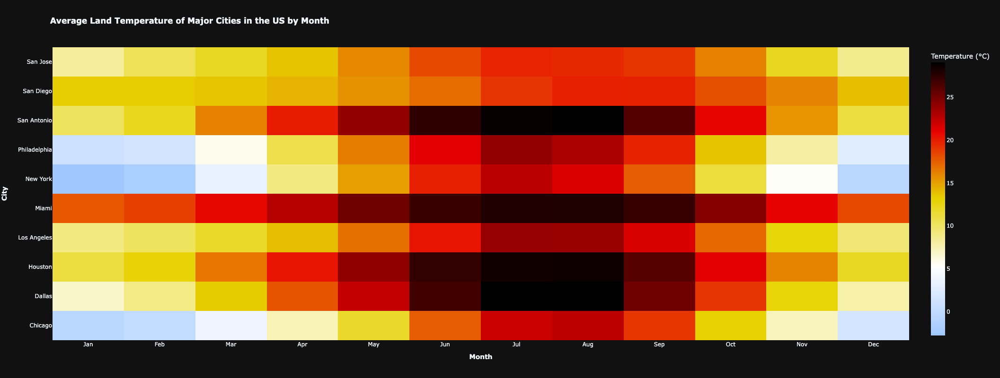

In [61]:
heatmap1 = go.Figure()

heatmap1.add_trace(go.Heatmap(
    z=cities_heatmap['AverageTemperature'],
    x=cities_heatmap['Month'],
    y=cities_heatmap['City'],
    colorscale='Blackbody_r',
    colorbar=dict(title='Temperature (°C)'),
    ))

heatmap1.update_layout(
    title='<b>Average Land Temperature of Major Cities in the US by Month</b>',
    template="plotly_dark",
    yaxis = dict(title = 'City', showticklabels=True),
    height=800,
    xaxis=dict(
        tickmode='array',
        tickvals=[1,2,3,4,5,6,7,8,9,10,11,12],
        ticktext=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']))
heatmap1.update_layout(showlegend=False)
heatmap1.update_yaxes(title='<b>City</b>')
heatmap1.update_xaxes(title='<b>Month</b>')

heatmap1.show()

# State Temperature Data

In [62]:
state_data

,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country
0,1855-05-01,25.544,1.171,Acre,Brazil
1,1855-06-01,24.228,1.103,Acre,Brazil
2,1855-07-01,24.371,1.044,Acre,Brazil
3,1855-08-01,25.427,1.073,Acre,Brazil
4,1855-09-01,25.675,1.014,Acre,Brazil
...,...,...,...,...,...
645670,2013-05-01,21.634,0.578,Zhejiang,China
645671,2013-06-01,24.679,0.596,Zhejiang,China
645672,2013-07-01,29.272,1.340,Zhejiang,China
645673,2013-08-01,29.202,0.869,Zhejiang,China


In [63]:
state_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 645675 entries, 0 to 645674
Data columns (total 5 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             645675 non-null  object 
 1   AverageTemperature             620027 non-null  float64
 2   AverageTemperatureUncertainty  620027 non-null  float64
 3   State                          645675 non-null  object 
 4   Country                        645675 non-null  object 
dtypes: float64(2), object(3)
memory usage: 24.6+ MB


In [64]:
state_data.describe()

,AverageTemperature,AverageTemperatureUncertainty
count,620027.000000,620027.000000
mean,8.993111,1.287647
std,13.772150,1.360392
min,-45.389000,0.036000
25%,-0.693000,0.316000
50%,11.199000,0.656000
75%,19.899000,1.850000
max,36.339000,12.646000


In [65]:
state_data.isnull().sum()

dt                                   0
AverageTemperature               25648
AverageTemperatureUncertainty    25648
State                                0
Country                              0
dtype: int64

In [66]:
state_temp = state_data.groupby(['Country','State']).mean().reset_index().sort_values('AverageTemperature', ascending=False).reset_index()
state_temp

,index,Country,State,AverageTemperature,AverageTemperatureUncertainty
0,92,India,Puducherry,27.266897,0.848816
1,67,India,Andaman And Nicobar,27.231677,0.855036
2,68,India,Andhra Pradesh,27.090003,0.890982
3,18,Brazil,Rio Grande Do Norte,27.011470,0.685854
4,96,India,Tamil Nadu,26.667812,0.851498
...,...,...,...,...,...
236,114,Russia,Chukot,-11.226295,1.872152
237,145,Russia,Maga Buryatdan,-11.228311,1.968724
238,165,Russia,Sakha,-12.859833,1.657453
239,174,Russia,Taymyr,-13.668526,2.560109


In [67]:
state_temp['Continent'] = coco.convert(names = state_temp['Country'], to = 'continent')
state_temp

,index,Country,State,AverageTemperature,AverageTemperatureUncertainty,Continent
0,92,India,Puducherry,27.266897,0.848816,Asia
1,67,India,Andaman And Nicobar,27.231677,0.855036,Asia
2,68,India,Andhra Pradesh,27.090003,0.890982,Asia
3,18,Brazil,Rio Grande Do Norte,27.011470,0.685854,America
4,96,India,Tamil Nadu,26.667812,0.851498,Asia
...,...,...,...,...,...,...
236,114,Russia,Chukot,-11.226295,1.872152,Europe
237,145,Russia,Maga Buryatdan,-11.228311,1.968724,Europe
238,165,Russia,Sakha,-12.859833,1.657453,Europe
239,174,Russia,Taymyr,-13.668526,2.560109,Europe


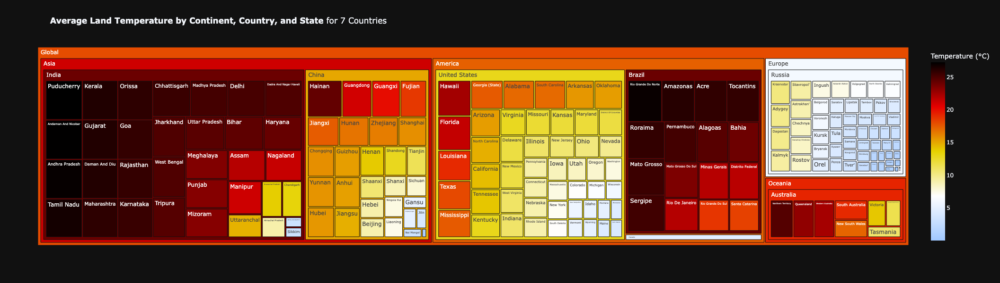

In [68]:
state_temp['Global'] = 'Global'
treemap1 = px.treemap(state_temp.head(200), path=['Global','Continent','Country','State'], values='AverageTemperature', color='AverageTemperature', labels={'AverageTemperature':'Temperature (°C)'}, title='<b>Average Land Temperature by Continent, Country, and State</b> for 7 Countries', color_continuous_scale='Blackbody_r', height=600, template="plotly_dark") # height=800, width=1400

treemap1.show()

In [69]:
states_temp2 = state_data.copy()
# states_temp2.dropna(axis=0, inplace=True)
             
states_temp2['Date'] = pd.to_datetime(state_data.dt)
states_temp2.drop(columns=['dt'], axis=1, inplace=True)

states_temp2['Day'] = states_temp2['Date'].dt.day
states_temp2['Month'] = states_temp2['Date'].dt.month
states_temp2['Year'] = states_temp2['Date'].dt.year

states_temp2

,AverageTemperature,AverageTemperatureUncertainty,State,Country,Date,Day,Month,Year
0,25.544,1.171,Acre,Brazil,1855-05-01,1,5,1855
1,24.228,1.103,Acre,Brazil,1855-06-01,1,6,1855
2,24.371,1.044,Acre,Brazil,1855-07-01,1,7,1855
3,25.427,1.073,Acre,Brazil,1855-08-01,1,8,1855
4,25.675,1.014,Acre,Brazil,1855-09-01,1,9,1855
...,...,...,...,...,...,...,...,...
645670,21.634,0.578,Zhejiang,China,2013-05-01,1,5,2013
645671,24.679,0.596,Zhejiang,China,2013-06-01,1,6,2013
645672,29.272,1.340,Zhejiang,China,2013-07-01,1,7,2013
645673,29.202,0.869,Zhejiang,China,2013-08-01,1,8,2013


In [70]:
us_temp = states_temp2.groupby(['Year','Month','Country','State']).mean().reset_index().sort_values('AverageTemperature', ascending=False).reset_index()
us_temp

,index,Year,Month,Country,State,AverageTemperature,AverageTemperatureUncertainty,Day
0,641895,2012,6,India,Delhi,36.339,0.385,1.0
1,592731,1995,6,India,Delhi,36.291,0.338,1.0
2,635888,2010,5,India,Rajasthan,36.205,0.306,1.0
3,410535,1932,6,India,Delhi,36.005,0.474,1.0
4,384507,1923,6,India,Delhi,35.988,0.348,1.0
...,...,...,...,...,...,...,...,...
645670,645621,2013,9,Russia,Yamal Nenets,NaN,NaN,1.0
645671,645622,2013,9,Russia,Yaroslavl',NaN,NaN,1.0
645672,645623,2013,9,Russia,Yevrey,NaN,NaN,1.0
645673,645625,2013,9,United States,Alaska,NaN,NaN,1.0


In [71]:
united_states = states_temp2[states_temp2['Country']=='United States']
us_recent = united_states[~(united_states['Year'] < 1900)]
us_recent

,AverageTemperature,AverageTemperatureUncertainty,State,Country,Date,Day,Month,Year
9332,6.286,0.537,Alabama,United States,1900-01-01,1,1,1900
9333,6.523,0.520,Alabama,United States,1900-02-01,1,2,1900
9334,11.213,0.372,Alabama,United States,1900-03-01,1,3,1900
9335,17.103,0.313,Alabama,United States,1900-04-01,1,4,1900
9336,21.311,0.350,Alabama,United States,1900-05-01,1,5,1900
...,...,...,...,...,...,...,...,...
626435,10.607,0.208,Wyoming,United States,2013-05-01,1,5,2013
626436,16.267,0.276,Wyoming,United States,2013-06-01,1,6,2013
626437,20.222,0.133,Wyoming,United States,2013-07-01,1,7,2013
626438,19.621,0.217,Wyoming,United States,2013-08-01,1,8,2013


In [72]:
us_recent.State.nunique()

51

In [73]:
us_recent.isnull().sum()

AverageTemperature               2
AverageTemperatureUncertainty    2
State                            0
Country                          0
Date                             0
Day                              0
Month                            0
Year                             0
dtype: int64

In [74]:
us_new_avg = us_recent.groupby(['State','Year'])['AverageTemperature'].mean().reset_index()
us_new_avg

,State,Year,AverageTemperature
0,Alabama,1900,17.059167
1,Alabama,1901,15.920583
2,Alabama,1902,17.081083
3,Alabama,1903,16.254000
4,Alabama,1904,16.696750
...,...,...,...
5809,Wyoming,2009,5.199917
5810,Wyoming,2010,5.756417
5811,Wyoming,2011,5.312250
5812,Wyoming,2012,7.306167


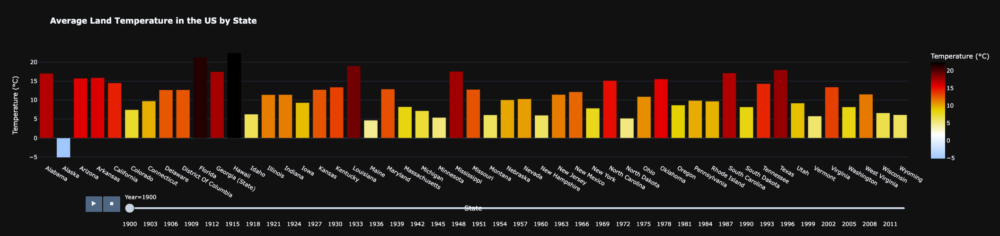

In [75]:
bar3 = px.bar(us_new_avg, x='State', y='AverageTemperature', color='AverageTemperature', animation_frame='Year', color_continuous_scale='blackbody_r', labels={'AverageTemperature':'Temperature (°C)'}, template='plotly_dark', title='<b>Average Land Temperature in the US by State</b>', height=500)
bar3.show()

In [76]:
us_monthly = us_recent.groupby(['Year','Month','State'])['AverageTemperature'].mean().reset_index()
us_monthly

,Year,Month,State,AverageTemperature
0,1900,1,Alabama,6.286
1,1900,1,Alaska,-23.739
2,1900,1,Arizona,7.265
3,1900,1,Arkansas,5.377
4,1900,1,California,7.876
...,...,...,...,...
69610,2013,9,Virginia,20.219
69611,2013,9,Washington,16.823
69612,2013,9,West Virginia,18.708
69613,2013,9,Wisconsin,16.567


In [77]:
us_monthly[us_monthly['State']=='Alaska']

,Year,Month,State,AverageTemperature
1,1900,1,Alaska,-23.739
52,1900,2,Alaska,-15.789
103,1900,3,Alaska,-12.253
154,1900,4,Alaska,-7.066
205,1900,5,Alaska,2.308
...,...,...,...,...
69361,2013,5,Alaska,1.695
69412,2013,6,Alaska,12.277
69463,2013,7,Alaska,13.009
69514,2013,8,Alaska,11.099


In [78]:
# major_us_states = ['New York', 'California', 'Illinois', 'Texas', 'Florida', 'Hawaii','Alaska','Arizona','Michigan',']
# us_states = us_monthly[us_monthly['State'].isin(major_us_states)]
# us_states

In [79]:
us_monthly

,Year,Month,State,AverageTemperature
0,1900,1,Alabama,6.286
1,1900,1,Alaska,-23.739
2,1900,1,Arizona,7.265
3,1900,1,Arkansas,5.377
4,1900,1,California,7.876
...,...,...,...,...
69610,2013,9,Virginia,20.219
69611,2013,9,Washington,16.823
69612,2013,9,West Virginia,18.708
69613,2013,9,Wisconsin,16.567


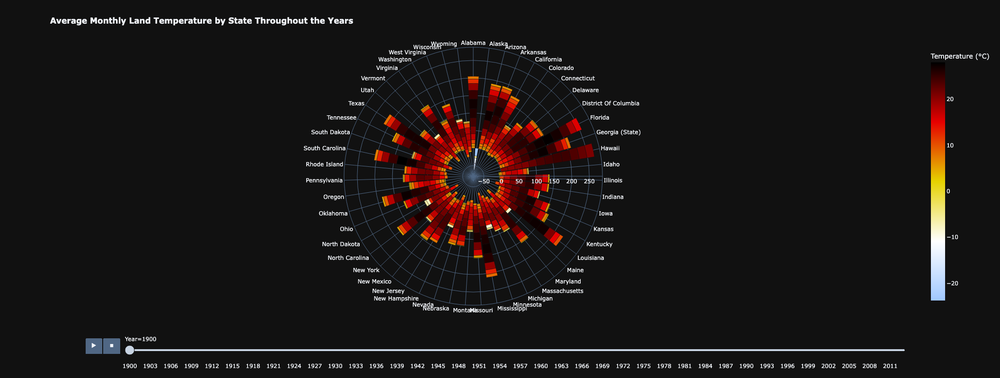

In [80]:
polar2 = px.bar_polar(us_monthly, r="AverageTemperature", theta="State",
                      color="AverageTemperature", template="plotly_dark",
                      animation_frame='Year',
                      color_continuous_scale= px.colors.sequential.Blackbody_r,
                      hover_data=['Month'],
                      title='<b>Average Monthly Land Temperature by State Throughout the Years</b>',
                      labels={'AverageTemperature':'Temperature (°C)'},
                      height=800)
polar2.show()

# Dashboard

### Saving new dataframes into csv files

These files are loaded into the python file that is connected to heroku.

In [81]:
# year_month.to_csv('./data/year_month.csv')
# overall_temp.to_csv('./data/overall_temp.csv')
# sea_ice_merged.to_csv('./data/sea_ice_merged.csv')
# ghg_merged.to_csv('./data/ghg_merged.csv')
# country_recent.to_csv('./data/country_recent.csv')
# cities_heatmap.to_csv('./data/cities_heatmap.csv')
# state_temp.to_csv('./data/state_temp.csv')
# us_new_avg.to_csv('./data/us_new_avg.csv')
# us_monthly.to_csv('./data/us_monthly.csv')

### All of the plots reflect the period between 1900 and 2013.
### Plots list:
#### Box Plots:
* **box1:** Average Land Temperature by Continent.

#### Line Plots:
* **line1:** Average Global Land Temperature and Temperature Error. **(not used in dashboard)**
* **line2:** Average Global Land & Ocean Temperature and Temperature Erro. **(not used in dashboard)**
* **line3:** Global Land and Ocean Temperature.
* **line4:** Land & Ocean Temperature and Sea-Ice Extent Relationship.
* **line5:** Land & Ocean Temperature and Greenhous Gases (GHG) Emissions Relationship.

#### Bar Charts:
* **bar1:** Average Global Land & Ocean Temperature by Month.
* **bar2:** GHG Emissions in kt Co2 equivelant.
* **bar3:** Average Land Temperature in the US by State.

#### Choropleth Maps:
* **map1:** World map showing average land temperature for each country.

#### Heatmaps:
* **heatmap1:** Average Land Temperature of Major Cities in the US by Month.

#### Treemaps:
* **treemap1:** Grouped by global, continent, country, and state for 7 countries [Australia, Brazil, Canada, China, India, Russia, United States].

#### Polar plots:
* **polar1:** Monthly Land & Ocean Temperature Throughout the Years. **(not used in dashboard)**
* **polar2:** Average Monthly Land Temperature by State Throughout the Years. **(not used in dashboard)**

In [82]:
app = Dash(__name__, external_stylesheets=[dbc.themes.COSMO])

colors = {
    'background': '#111111',
    'title': '#82c7a5',
    'body': '#FFFFFF',
}

app.layout = html.Div(style={'backgroundColor': colors['background'],'background-size': 'cover'}, children = [
    dbc.Row(
        [html.H1(children='Climate Change: Surface Temperature Dashboard',
                style={
                    'textAlign': 'center',
                    'color': colors['title'],
                    'padding': 10
                }),
        html.H5(children='This dashboard utilizes various charts and plots to visualize land and ocean temperatures across the globe between 1900 and 2013.',
              style={
                    'textAlign': 'center',
                    'color': colors['body'],
                    'padding': 10
                })]),
    dbc.Row(
          [dbc.Col(dcc.Graph(id = 'graph1', figure = map1), width=8, style={'padding': 20}),
           dbc.Col(dcc.Graph(id = 'graph2', figure = line3), width=4, style={'padding': 20})]),
    dbc.Row(
          dbc.Col(dcc.Graph(id = 'graph7', figure = treemap1))),
    dbc.Row(
          [dbc.Col(dcc.Graph(id = 'graph5', figure = bar1), width=6, style={'padding': 20}),
          dbc.Col(dcc.Graph(id = 'graph6', figure = box1), width=6, style={'padding': 20})]),
    html.Hr(style={'color':'#FFFFFF'}),
    dbc.Row(
          html.H2(children='Taking a Closer Look on the United States',
                style={
                    'textAlign': 'center',
                    'color': colors['title'],
                    'padding': 10
                })),
    dbc.Row(
          [dbc.Col(dcc.Graph(id = 'graph8', figure = heatmap1, style={'padding': 20}), width=5),
          dbc.Col(dcc.Graph(id = 'graph9', figure = polar2, style={'padding': 20}), width=7)]),
    html.Hr(style={'color':'#FFFFFF'}),
    dbc.Row(
          html.H2(children='Temperature Relationship with Sea-Ice Extent and GHG Emissions',
                style={
                    'textAlign': 'center',
                    'color': colors['title'],
                    'padding': 10
                })),
    dbc.Row(
          [dbc.Col(dcc.Graph(id = 'graph3', figure = line4), width=6, style={'padding': 20}),
          dbc.Col(dcc.Graph(id = 'graph4', figure = line5), width=6, style={'padding': 20})]),
]
)

# Running app locally
if __name__=='__main__':
    app.run_server(debug=False, port=2780)

Dash is running on http://127.0.0.1:2780/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:2780/ (Press CTRL+C to quit)
127.0.0.1 - - [01/Aug/2022 21:45:48] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [01/Aug/2022 21:45:48] "GET /_dash-component-suites/dash/dcc/dash_core_components.v2_6_0m1658516344.js HTTP/1.1" 200 -
127.0.0.1 - - [01/Aug/2022 21:45:48] "GET /_dash-dependencies HTTP/1.1" 200 -
127.0.0.1 - - [01/Aug/2022 21:45:49] "GET /_dash-layout HTTP/1.1" 200 -
127.0.0.1 - - [01/Aug/2022 21:45:49] "GET /_dash-component-suites/dash/dcc/async-graph.js HTTP/1.1" 304 -
127.0.0.1 - - [01/Aug/2022 21:45:49] "GET /_dash-component-suites/dash/dcc/async-plotlyjs.js HTTP/1.1" 200 -
